In [41]:
# 모듈 분리
import gym                                  # OpenAI Gym 0.26.x
import gymnasium as gymn                    # Gymnasium
import os
from stable_baselines3.common.vec_env import DummyVecEnv, VecTransposeImage
from stable_baselines3.common.evaluation import evaluate_policy  #to evaluate the model 
from stable_baselines3.common.callbacks import EvalCallback

# Plot Results

In [42]:
# 모듈 분리
import gym                                  # OpenAI Gym 0.26.x
import gymnasium as gymn                    # Gymnasium

# import gymnasium as gym

import numpy as np
from gymnasium import spaces
from stable_baselines3 import DQN
from stable_baselines3.common.vec_env import VecTransposeImage
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3.common.callbacks import EvalCallback
import os


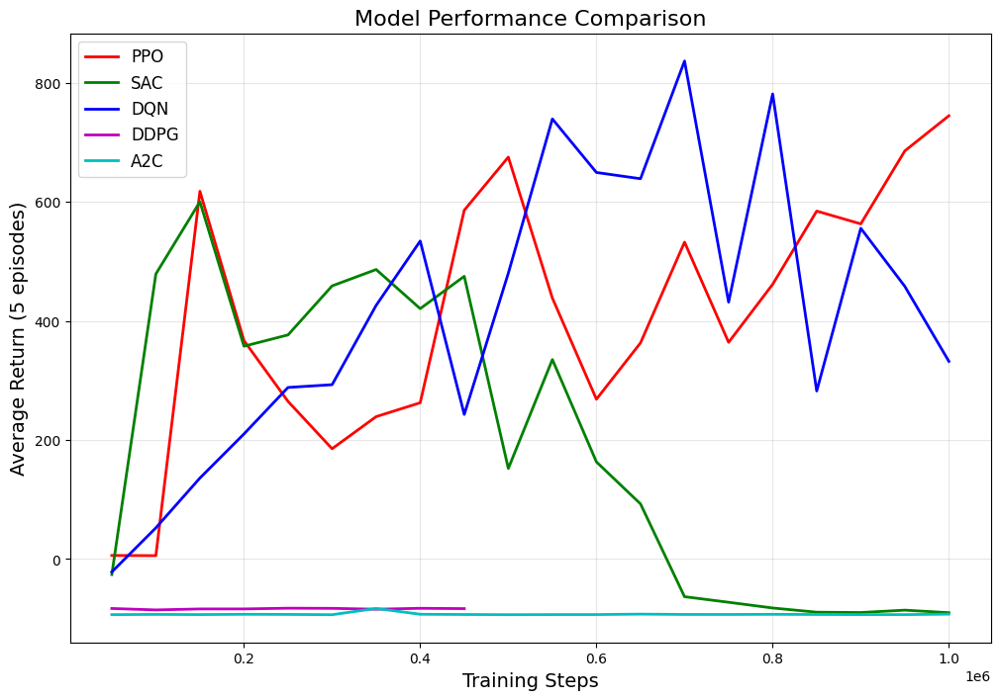

In [43]:
import glob
import matplotlib.pyplot as plt
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator

# 비교할 모델들의 로그 디렉토리 경로 지정
log_dirs = [
    '../Training/Logs/PPO',
    '../Training/Logs/SAC',
    '../Training/Logs/DQN',
    '../Training/Logs/DDPG',
    '../Training/Logs/A2C'
]

plt.figure(figsize=(12, 8))
colors = ['r-', 'g-', 'b-', 'm-', 'c-']
labels = ['PPO', 'SAC', 'DQN', 'DDPG', 'A2C']

for idx, log_dir in enumerate(log_dirs):
    event_file = glob.glob(f"{log_dir}/events.out.tfevents.*")[0]
    
    # TensorBoard 이벤트 데이터 파싱
    event_acc = EventAccumulator(event_file)
    event_acc.Reload()
    
    # 평가 평균 리워드 추출
    steps = [x.step for x in event_acc.Scalars('eval/mean_reward')]
    rewards = [x.value for x in event_acc.Scalars('eval/mean_reward')]
    
    # 그래프 플롯
    plt.plot(steps, rewards, colors[idx], linewidth=2, label=labels[idx])

plt.xlabel('Training Steps', fontsize=14)
plt.ylabel('Average Return (5 episodes)', fontsize=14)
plt.title('Model Performance Comparison', fontsize=16)
plt.legend(fontsize=12)
plt.grid(True, alpha=0.3)
plt.show()


## Test Env Augmentation

In [44]:
# import gym
import gymnasium as gymn
import os

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from stable_baselines3 import PPO      #PPO -> Proximal Policy Optimization
from stable_baselines3.common.vec_env import DummyVecEnv, VecTransposeImage
from stable_baselines3.common.evaluation import evaluate_policy  #to evaluate the model 
from stable_baselines3.common.callbacks import EvalCallback

In [45]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1024, 768))
display.start()

from matplotlib import pyplot as plt, animation
%matplotlib inline
from IPython import display

def create_anim(frames, dpi, fps):
    plt.figure(figsize=(frames[0].shape[1] / dpi, frames[0].shape[0] / dpi), dpi=dpi)
    patch = plt.imshow(frames[0])
    def setup():
        plt.axis('off')
    def animate(i):
        patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, init_func=setup, frames=len(frames), interval=fps)
    return anim

def display_anim(frames, dpi=72, fps=60):
    anim = create_anim(frames, dpi, fps)
    return anim.to_jshtml()

def save_anim(frames, filename, dpi=72, fps=50):
    anim = create_anim(frames, dpi, fps)
    anim.save(filename)


class trigger:
    def __init__(self):
        self._trigger = True

    def __call__(self, e):
        return self._trigger

    def set(self, t):
        self._trigger = t


### 야간 주행 wrapper

In [48]:
class NightDrivingWrapper(gymn.ObservationWrapper):
    def __init__(self, env, brightness_scale=0.3):
        super().__init__(env)
        self.brightness_scale = brightness_scale

    def observation(self, obs):
        # 도로 마스크는 밝기 조절 전에 계산
        road_mask = (obs[..., 0] > 90) & (obs[..., 0] < 110) & \
                    (obs[..., 1] > 90) & (obs[..., 1] < 110) & \
                    (obs[..., 2] > 90) & (obs[..., 2] < 110)
        
        obs = obs.copy()
        obs[road_mask] = [102, 102, 170]  # 도로를 진한 파란색으로 변경
        
        # 마지막에 밝기 조절
        obs = (obs * self.brightness_scale).clip(0, 255).astype(np.uint8)
        return obs

    def render(self):
        frame = self.env.render()

        road_mask = (frame[..., 0] > 90) & (frame[..., 0] < 110) & \
                    (frame[..., 1] > 90) & (frame[..., 1] < 110) & \
                    (frame[..., 2] > 90) & (frame[..., 2] < 110)
        
        frame = frame.copy()
        frame[road_mask] = [102, 102, 170]

        frame = (frame * self.brightness_scale).clip(0, 255).astype(np.uint8)
        return frame

### 64 x 64 x 1 전용 Env (Gray Sclale)

In [7]:
# 모듈 분리
import gym                                  # OpenAI Gym 0.26.x
import gymnasium as gymn                    # Gymnasium

# import gymnasium as gym

import numpy as np
from gymnasium import spaces
from stable_baselines3 import DQN
from stable_baselines3.common.vec_env import VecTransposeImage
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3.common.callbacks import EvalCallback
import os
import gc

class DiscreteActionWrapper(gymn.ActionWrapper):
    def __init__(self, env):
        super().__init__(env)
        self.actions = [
            [-1.0, 0.0, 0.0],  # 좌회전
            [0.0, 0.0, 0.0],   # 정지
            [1.0, 0.0, 0.0],   # 우회전
            [0.0, 1.0, 0.0],   # 가속
            [0.0, 0.0, 1.0]    # 브레이크
        ]
        self.action_space = spaces.Discrete(len(self.actions))

    def action(self, action):
        return np.array(self.actions[action], dtype=np.float32)


In [49]:
class FrameSkipWrapper(gymn.Wrapper):
    def __init__(self, env, skip=4):
        super().__init__(env)
        self._skip = skip

    def step(self, action):
        total_reward = 0.0
        done = False
        info = {}
        for _ in range(self._skip):
            obs, reward, done, truncated, info = self.env.step(action)
            total_reward += reward
            if done or truncated:
                break
        return obs, total_reward, done, truncated, info


In [50]:
class CustomGrayScaleWrapper(gymn.ObservationWrapper):
    def __init__(self, env, keep_dim=True):
        super().__init__(env)
        self.keep_dim = keep_dim
        obs_shape = self.observation_space.shape
        h, w = obs_shape[0], obs_shape[1]
        c = (1,) if keep_dim else ()
        self.observation_space = gymn.spaces.Box(
            low=0, high=255,
            shape=(h, w) + c,
            dtype=np.uint8
        )

    def observation(self, obs):
        # Convert RGB to grayscale using the luminosity method
        gray = np.dot(obs[..., :3], [0.299, 0.587, 0.114])
        if self.keep_dim:
            gray = gray[..., np.newaxis]  # shape (H, W, 1)
        return gray.astype(np.uint8)

In [62]:
# from gymnasium.wrappers.pixel_observation import GrayScaleObservation
from gymnasium.wrappers import ResizeObservation

def make_env():
    env = gymn.make(
        "CarRacing-v2",
        render_mode="rgb_array",
        # continuous=True
    )
    env = NightDrivingWrapper(env, brightness_scale=0.85)
    
    # env = DiscreteActionWrapper(env)
    # env = FrameSkipWrapper(env, skip=4)
    # 해상도 축소
    # env = ResizeObservation(env, (64, 64))
    # 흑백 적용
    # env = CustomGrayScaleWrapper(env, keep_dim=True) 
    
    return env

### 96 x 96 x 3 전용 Env

In [45]:
# # from gymnasium.wrappers.pixel_observation import GrayScaleObservation
# from gymnasium.wrappers import ResizeObservation

# def make_env():
#     env = gymn.make(
#         "CarRacing-v2",
#         render_mode="rgb_array",
#         # continuous=True
#     )
#     # env = NightDrivingWrapper(env, brightness_scale=0.75)
    
#     # 해상도 축소
#     # env = ResizeObservation(env, (64, 64))
#     # 흑백 적용
#     # env = CustomGrayScaleWrapper(env, keep_dim=True) 
#     return env

In [11]:
# PPO Env original

# environment_name = "CarRacing-v2"
# env = gym.make(environment_name)
# env = DummyVecEnv([lambda: env])
# from gymnasium.wrappers import ResizeObservation

def make_env():
    env = gymn.make("CarRacing-v2", render_mode="rgb_array")
    # env = NightDrivingWrapper(env, brightness_scale=0.75)
    original_reset = env.reset
    original_step = env.step
    
    # reset: 새로운 에피소드 시작할 때 처음 위치로 자동차를 리셋, 관측값만 반환
    def new_reset(*args, **kwargs):
        # return original_reset(*args, **kwargs)[0]
        obs, info = original_reset(*args, **kwargs)
        return obs, info
    

# step: 강화학습에서 에이전트가 행동을 취했을 때, 환경이 어떻게 변하는지를 반환하는 함수 -> 보통 아래와 같은 값들을 반환
# obs: 다음 관측(observation, 상태)
# reward: 보상값
# terminated: 목표 달성/실패로 인한 자연스러운 종료
# truncated: 시간 제한 등 외적 이유로 인한 종료
# info: 추가 정보 (딕셔너리)

# step: 4개 값 반환 (구버전 호환)
    def new_step(action):
        # obs, reward, terminated, truncated, info = original_step(action)
        # done = terminated or truncated
        # return obs, reward, done, info
        obs, reward, terminated, truncated, info = original_step(action)
        return obs, reward, terminated, truncated, info
    
    env.reset = new_reset
    env.step = new_step
    
    return env

### Test 결과 확인

In [63]:
# 기존 코드 유지
from stable_baselines3 import PPO

# from stable_baselines3 import SAC

test_env = DummyVecEnv([make_env])
test_env = VecTransposeImage(test_env)

model_path = os.path.join('../Training/Saved_Models/PPO/PPO_best_model/best_model.zip')
# model_path = os.path.join('../Training/Saved_Models/SAC/SAC_best_model/best_model.zip')
model = PPO.load(model_path, env=test_env)

/home/aquila/anaconda3/envs/car_racing/lib/python3.8/site-packages/stable_baselines3/common/save_util.py:437: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  th_object = th.lo

### DQN 전용

In [24]:
# NatureCNN 클래스 정확한 임포트 추가
from stable_baselines3.common.torch_layers import NatureCNN  # [1][2]

# 기존 코드 유지
from stable_baselines3 import DQN

# from stable_baselines3 import SAC

test_env = DummyVecEnv([make_env])
test_env = VecTransposeImage(test_env)

model_path = os.path.join('../Training/Saved_Models/DQN/DQN_best_model/best_model.zip')
# model_path = os.path.join('../Training/Saved_Models/SAC/SAC_best_model/best_model.zip')

model = DQN.load(
    model_path,
    env=test_env,
    policy="CnnPolicy",
    # policy_kwargs={
    #     "features_extractor_class": NatureCNN,
    #     "features_extractor_kwargs": dict(features_dim=512)
    # },
    device="cuda:0"
)

ValueError: loaded state dict contains a parameter group that doesn't match the size of optimizer's group

### Evaluation

In [13]:
evalue = evaluate_policy(model, test_env, n_eval_episodes=10)
test_env.close()
evalue

/home/aquila/anaconda3/envs/car_racing/lib/python3.8/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


(741.7998717471958, 158.5719499198102)

In [64]:
episodes = 1
frames = []
for episode in range(1, episodes+1):
    obs = test_env.reset()  #state = env.reset()
    done = False
    score = 0
    
    while not done:
        frame = test_env.envs[0].render()  # mode 인자 없이!
        frames.append(frame)
        action , _ = model.predict(obs) 
        obs, reward, done, info = test_env.step(action) 
        score += reward
    print("Episode:{} Score:{}".format(episode,score))
test_env.close()

Episode:1 Score:[289.65298]


### Evaluation (GrayScale 출력)

In [26]:
import cv2
episodes = 1
frames = []
for episode in range(1, episodes+1):
    obs = test_env.reset()
    done = False
    score = 0.0  # float 타입으로 초기화
    
    while not done:
        frame = obs[0].transpose(1, 2, 0)
        frame = np.repeat(frame, 3, axis=2)
        # 이미지 3배 확대 (192x192)
        resized_frame = cv2.resize(
            frame, 
            (192, 192), 
            interpolation=cv2.INTER_CUBIC  # [1]
        )
        frames.append(resized_frame)
        # frames.append(frame)
        
        action, _ = model.predict(obs, deterministic=True) 
        obs, reward, done, info = test_env.step(action)
        score += float(reward)  # float으로 명시적 변환 [1][2]
        
    print(f"Episode:{episode} Score:{score:.1f}")  # 정상 출력
test_env.close()

KeyboardInterrupt: 

Animation size has reached 20986173 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


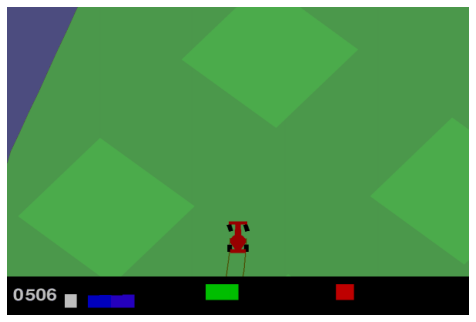

In [60]:
display.HTML(display_anim(frames))

## Video 저장

In [61]:
import os
import cv2

save_dir = '../outputs/videos/PPO'  # 저장할 디렉토리 경로
os.makedirs(save_dir, exist_ok=True)  # 디렉토리가 없으면 생성

save_path = os.path.join(save_dir, 'PPO_Grayscale_trained.mp4')  # 전체 저장 경로

if frames:
    # 프레임 크기 확인
    height, width, channels = frames[0].shape
    
    # VideoWriter 설정
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # 또는 'XVID'
    fps = 30  # 원하는 프레임율
    out = cv2.VideoWriter(save_path, fourcc, fps, (width, height))
    
    # 프레임을 비디오에 저장
    for frame in frames:
        # OpenCV는 BGR 형식을 사용하므로 RGB에서 BGR로 변환
        frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        out.write(frame_bgr)
    
    out.release()
    print(f"비디오가 '{save_path}'로 저장되었습니다.")
else:
    print("저장할 프레임이 없습니다.")



비디오가 '../outputs/videos/PPO/PPO_Grayscale_trained.mp4'로 저장되었습니다.


In [24]:
import cv2
import numpy as np

episodes = 1
frames = []
for episode in range(1, episodes+1):
    obs = test_env.reset()
    done = False
    score = 0
    
    while not done:
        frame = test_env.envs[0].render()
        frames.append(frame)
        action, _ = model.predict(obs) 
        obs, reward, done, info = test_env.step(action) 
        score += reward
    print("Episode:{} Score:{}".format(episode, score))

# 비디오 저장
if frames:
    # 프레임 크기 확인
    height, width, channels = frames[0].shape
    
    # VideoWriter 설정
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # 또는 'XVID'
    fps = 30  # 원하는 프레임율
    out = cv2.VideoWriter('car_racing_video.mp4', fourcc, fps, (width, height))
    
    # 프레임을 비디오에 저장
    for frame in frames:
        # OpenCV는 BGR 형식을 사용하므로 RGB에서 BGR로 변환
        frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        out.write(frame_bgr)
    
    out.release()
    print("비디오가 'car_racing_video.mp4'로 저장되었습니다.")

test_env.close()

Episode:1 Score:[91.17711]
비디오가 'car_racing_video.mp4'로 저장되었습니다.
